--------------------------
Project: FSDS final group work

Group: CheerUp

Tentative title: VACATION HOMES OR CRIME MAGNETS

Due Date: December 19, 2023.

Insights: Aibnb density is connected to higher incidents of (person/property) crime, citing various literatures from cities around the world

Policy recommendation: TBD. Some ideas (NEED LITERATURE TO BACKUP)

If there are relationships

1. Reactive: Increase police presence in areas with high Airbnb density
2. Proactive: Limit Airbnb density in areas with high crime rates of a certain type
3. Collaborative: Airbnb to share data with local police departments to help them identify areas with high Airbnb density
4. Punitive: Airbnb to pay a fine for every crime incident that occurs in areas with high Airbnb density
5. Preventive: Airbnb to pay for additional security cameras in areas with high Airbnb density 

If not: Other cities this but London doesn't see the same issue. Should look at improving crime by improving other aspects...

--------------------------

### Data loading and cleaning (if necessary)



Task 0a: Set up libraries and function

In [1]:
# Load all libraries
import os
from requests import get
from urllib.parse import urlparse
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import json
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
# Function to download files from remote
def cache_data(src:str, dest:str) -> str:
    """
    Create a folder to store file from URL.
    If folder doesn't already exists, then create one, before writing the file.

    src : URL
    dest : location on local drive
    """    
    url = urlparse(src) # We assume that this is some kind of valid URL 
    fn  = os.path.split(url.path)[-1] # Extract the filename
    dfn = os.path.join(dest,fn) #Destination filename as path
    
    if not os.path.isfile(dfn):        
        print(f"{dfn} not found, downloading!")
        path = os.path.split(dest)
        if len(path) >= 1 and path[0] != '':
            os.makedirs(os.path.join(*path), exist_ok=True)            
        with open(dfn, "wb") as file:
            response = get(src)
            file.write(response.content)            
        print("\tDone downloading...")
    else:
        print(f"Found {dfn} locally!")
    return dfn

def plt_ldn(w, b):
    """
    Creates a new figure of a standard size with the 
    water (w) and boundary (b) layers set up for easy
    plotting. Right now this function assumes that you're
    looking at London, but you could parameterise it in
    other ways ot allow it to work for other areas.
    
    w: a water layer for London
    b: a borough (or other) boundary layer for London
    """
    fig, ax = plt.subplots(1, figsize=(14, 12))
    w.plot(ax=ax, color='#79aef5', zorder=2)
    b.plot(ax=ax, edgecolor='#cc2d2d', facecolor='None', zorder=3)
    ax.set_xlim([502000,563000])
    ax.set_ylim([155000,201500])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    return fig, ax

In [3]:
# Define paths
ddir  = os.path.join('data','geo') # destination directory
spath = 'https://github.com/jreades/i2p/blob/master/data/src/' # source path
spath_db = 'https://www.dropbox.com/scl/fi/' # source path for dropbox
host = 'http://orca.casa.ucl.ac.uk'
path = '~jreades/data'

In [4]:
# Read in airbnb, crime, and lsoa stats files. https://www.dropbox.com/home/casa/casa_fsds_cheers. 
# Some files have been cleaned, cropped, turned into gdf and hosted on dropbox to save time later on. See cleandata.ipynb in the Github repo for more details on how these files were created.
# # [PATIENCE] Takes about 4 minutes to download and read in the data

# Crime data filtered for September 2023, within Greater London
crime = gpd.read_file(cache_data(spath_db + 'ewc9skqcfr930whzcjadd/crime.gpkg?rlkey=xjve2mmmmt5h3allsa2zpabya&dl=1', ddir),driver='gpkg',low_memory=False)

# Airbnb listing data scraped on September 2023, filtered within Greater London
listings = gpd.read_parquet( cache_data(f'{host}/{path}/2023-09-06-listings.geoparquet', ddir))
listings = listings.to_crs(epsg=27700)

# LSOA (London) data concatenated from multiple datasets from London Datastore,
lsoa_stat = pd.read_csv(cache_data(spath_db + '8zc0g09rlf1yhj6j7yn6n/lsoa_full.csv?rlkey=yopr4hv017rr3iv4e2zus0ifz&dl=1', ddir), low_memory=False)

print('Done.')

Found data/geo/crime.gpkg locally!
Found data/geo/2023-09-06-listings.geoparquet locally!
Found data/geo/lsoa_full.csv locally!
Done.


In [5]:
# Read in shapefiles (2 mins)
water = gpd.read_file(cache_data(spath+'Water.gpkg?raw=true', ddir))
green = gpd.read_file(cache_data(spath+'Greenspace.gpkg?raw=true', ddir))
boros = gpd.read_file(cache_data(spath+'Boroughs.gpkg?raw=true', ddir))
lsoa = gpd.read_file(cache_data(spath_db+'u367zlorie8vuluugy2fr/lsoa_london.gpkg?rlkey=rc7rdnlfdmzfgy5q7ujz9pnwj&dl=1', ddir))
print('Done.')

Found data/geo/Water.gpkg locally!
Found data/geo/Greenspace.gpkg locally!
Found data/geo/Boroughs.gpkg locally!
Found data/geo/lsoa_london.gpkg locally!
Done.


In [6]:
#Check CRS for all geo dataframes
print(water.crs, green.crs, boros.crs, lsoa.crs, crime.crs, listings.crs)
# All dataframes are in EPSG:27700

EPSG:27700 EPSG:27700 EPSG:27700 EPSG:27700 EPSG:27700 EPSG:27700


<Axes: >

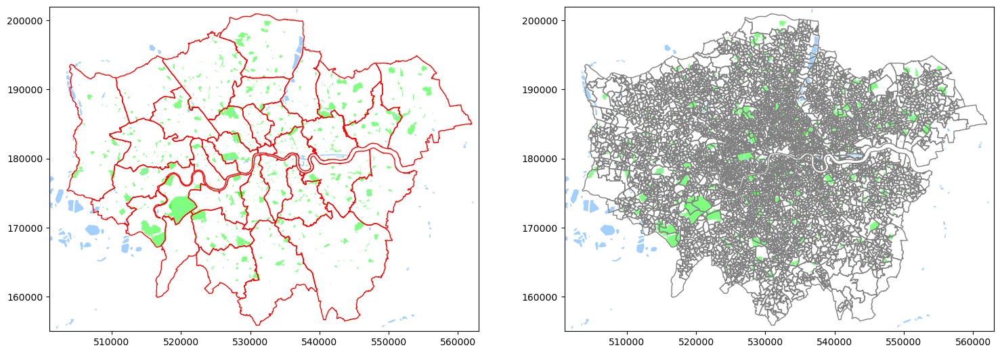

In [7]:
# Plot London map to confirm geometries are correct
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(18,24))

for ax in (ax1,ax2):
    green.plot(edgecolor=None, facecolor=(0,1,0,0.5), ax=ax)
    water.plot(edgecolor=None,facecolor='#a2cffe',ax=ax)
    ax.set_xlim([501000, 563000])
    ax.set_ylim([155000, 202000])
    
boros.plot(edgecolor='red', facecolor='None',ax=ax1)
lsoa.plot(edgecolor='grey', facecolor='None',ax=ax2)

Text(0.5, 1.0, 'Crimes in London, Sep 2023, Metropolitan Police')

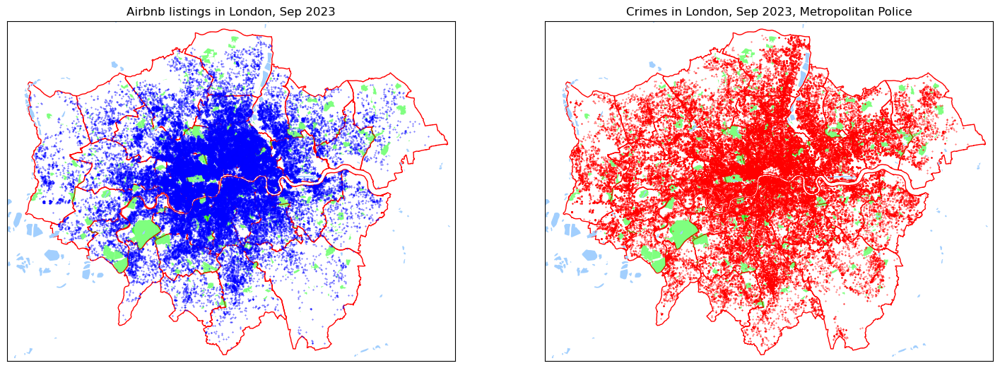

In [8]:
# Plot airbnb listings and crime incidents
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(18,24))

# Set the x and y limits
for ax in fig.get_axes():
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
    ax.set_xlim([501000, 563000])
    ax.set_ylim([155000, 202000])
    boros.plot(edgecolor='red', facecolor='None',ax=ax)
    green.plot(edgecolor=None, facecolor=(0,1,0,0.5), ax=ax)
    water.plot(edgecolor=None,facecolor='#a2cffe',ax=ax)

listings.plot(ax=ax1, markersize=0.1,facecolor='blue')  
ax1.set_title('Airbnb listings in London, Sep 2023')

crime.plot(ax=ax2, markersize=0.1,facecolor='red')
ax2.set_title('Crimes in London, Sep 2023, Metropolitan Police')

In [9]:
crime.tail()

,Unnamed: 0,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context,geometry
94954,3305419,e428fac4484cdbc20c86bf044f61ba05942d1846ada823...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.136234,51.487435,On or near Chichester Street,E01035722,Westminster 024G,Public order,Under investigation,NaN,POINT (529498.284 178144.827)
94955,3305420,05c84401ec7d2129496a921746308384fe927f2232032a...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.137230,51.486309,On or near Parking Area,E01035722,Westminster 024G,Theft from the person,Investigation complete; no suspect identified,NaN,POINT (529432.323 178017.855)
94956,3305421,dd42dcf68782f8aa553c15cac4f2ea7c13536a8b732852...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.136284,51.485152,On or near Petrol Station,E01035722,Westminster 024G,Vehicle crime,Investigation complete; no suspect identified,NaN,POINT (529501.275 177890.866)
94957,3305422,9f2606828fc8e67fe813a95865c2bd69c7464878dfa7ce...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.136234,51.487435,On or near Chichester Street,E01035722,Westminster 024G,Violence and sexual offences,Investigation complete; no suspect identified,NaN,POINT (529498.284 178144.827)
94958,3305423,db15663fb2259a3de5bb2d5147ee8b524b84bade3d76df...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.133480,51.486807,On or near St George'S Square Mews,E01035722,Westminster 024G,Violence and sexual offences,Investigation complete; no suspect identified,NaN,POINT (529691.259 178079.863)


In [10]:
# Clean crime data: outliers, and missing values, split into 2 types by severity
crime_property = ['Burglary', 'Criminal damage and arson',  'Theft from the person', 'Vehicle crime', 'Shoplifting', 'Bicycle theft']
crime_violent = ['Robbery', 'Violence and sexual offences']  
crime_publicorder = ['Anti-social behaviour', 'Public order','Drugs','Possession of weapons']
# Need rationalization when writing the report

# Omit rows with Other Crime and Other Theft
crime = crime[~crime['Crime type'].isin(['Other theft','Other crime'])]
# Create a new column for crime type
crime['Category'] = np.where(crime['Crime type'].isin(crime_property), 'Property crime',
                             np.where(crime['Crime type'].isin(crime_violent), 'Violent crime','Public Order crime'))
crime.tail()

/opt/conda/lib/python3.11/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,Unnamed: 0,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context,geometry,Category
94954,3305419,e428fac4484cdbc20c86bf044f61ba05942d1846ada823...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.136234,51.487435,On or near Chichester Street,E01035722,Westminster 024G,Public order,Under investigation,NaN,POINT (529498.284 178144.827),Public Order crime
94955,3305420,05c84401ec7d2129496a921746308384fe927f2232032a...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.137230,51.486309,On or near Parking Area,E01035722,Westminster 024G,Theft from the person,Investigation complete; no suspect identified,NaN,POINT (529432.323 178017.855),Property crime
94956,3305421,dd42dcf68782f8aa553c15cac4f2ea7c13536a8b732852...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.136284,51.485152,On or near Petrol Station,E01035722,Westminster 024G,Vehicle crime,Investigation complete; no suspect identified,NaN,POINT (529501.275 177890.866),Property crime
94957,3305422,9f2606828fc8e67fe813a95865c2bd69c7464878dfa7ce...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.136234,51.487435,On or near Chichester Street,E01035722,Westminster 024G,Violence and sexual offences,Investigation complete; no suspect identified,NaN,POINT (529498.284 178144.827),Violent crime
94958,3305423,db15663fb2259a3de5bb2d5147ee8b524b84bade3d76df...,2023-09,Metropolitan Police Service,Metropolitan Police Service,-0.133480,51.486807,On or near St George'S Square Mews,E01035722,Westminster 024G,Violence and sexual offences,Investigation complete; no suspect identified,NaN,POINT (529691.259 178079.863),Violent crime


<Axes: >

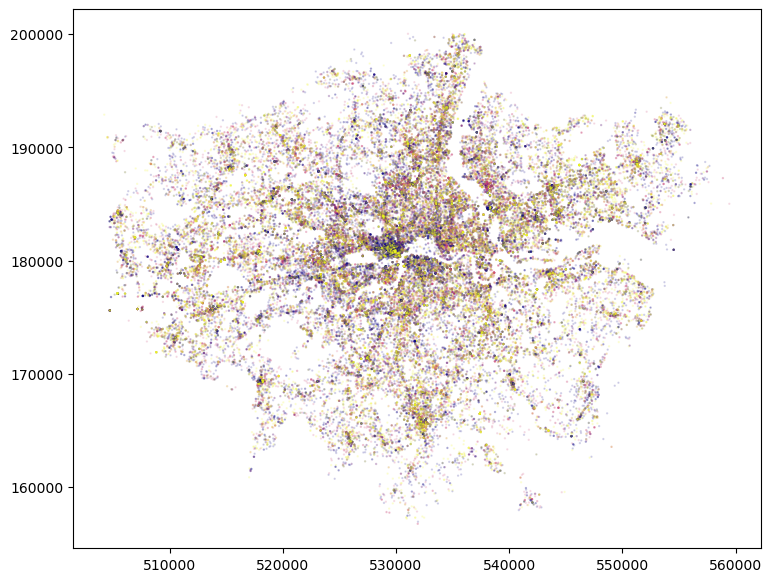

In [11]:
crime.plot(column='Category', cmap='plasma', markersize=.5, alpha=0.15, figsize=(10,7))

<Axes: >

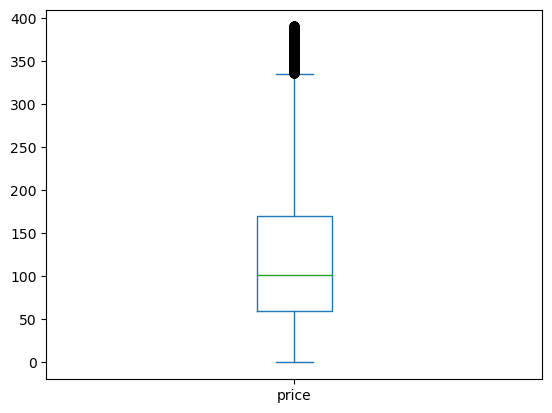

In [12]:
# Clean listings data: outliers, and missing values, split into 3 types by property type
# Omit rows with Hotel room
listings = listings[~listings['room_type'].isin(['Hotel room'])]

# Transform price to float
if listings.price.dtype == 'O':
    listings.price = listings.price.str.replace('$','').str.replace(',','').astype(float).round(2)

# Trim outliers in terms of price based on interquartile range, because they are most likely they are not real listings
q1 = listings.price.quantile(0.25)
q3 = listings.price.quantile(0.75)
iqr = q3 - q1
listings = listings[(listings.price >= q1 - 1.5*iqr) & (listings.price <= q3 + 1.5*iqr)]
listings.price.plot.box()

In [13]:
lsoa.head()

,OBJECTID,LSOA21CD,LSOA21NM,GlobalID,geometry
0,1,E01000001,City of London 001A,f1865556-4e62-48e3-a025-d93a40f15e46,"POLYGON ((532105.312 182010.574, 532162.491 18..."
1,2,E01000002,City of London 001B,83e78aad-ee05-44a5-a8d3-077de6ed4053,"POLYGON ((532634.497 181926.016, 532619.141 18..."
2,3,E01000003,City of London 001C,69c457df-229e-4446-9577-95ac1c9be694,"POLYGON ((532135.138 182198.131, 532158.250 18..."
3,4,E01000005,City of London 001E,d537d59f-237a-45ed-a514-b0ab2a93e510,"POLYGON ((533808.018 180767.774, 533649.037 18..."
4,5,E01000006,Barking and Dagenham 016A,8d0081fe-69e2-48ac-aaf9-fd270d60e339,"POLYGON ((545122.049 184314.931, 545271.849 18..."


### Descriptive statistics (Question #6 - 18 points)

*Objective:* 
Show the clustering of airbnb (by type), and crime incidents (by type). Show possible correlations between airbnb density and crime incidents
Approach: 

1. Split airbnb listing by 3 types (entire house/private room/shared room), and crime by 2 types (person vs property)
2. Plot out all the airbnb listings.
     - Heat map (KDE for each)
     - Descriptive statistics for each (LSOA min, max, mean, median)
3. Plot all the crime incidents, split by .
    - Heat map (KDE for each)
    - Descriptive statistics for each (LSOA min, max, mean, median)
4. Visual observation based on the heatmaps above where airbnb listings and crimes seem to overlap
5. Run correlations
-------------------------------------------------------------------------------

Task 1: Produce heat map for each type of airbnb listings against crime

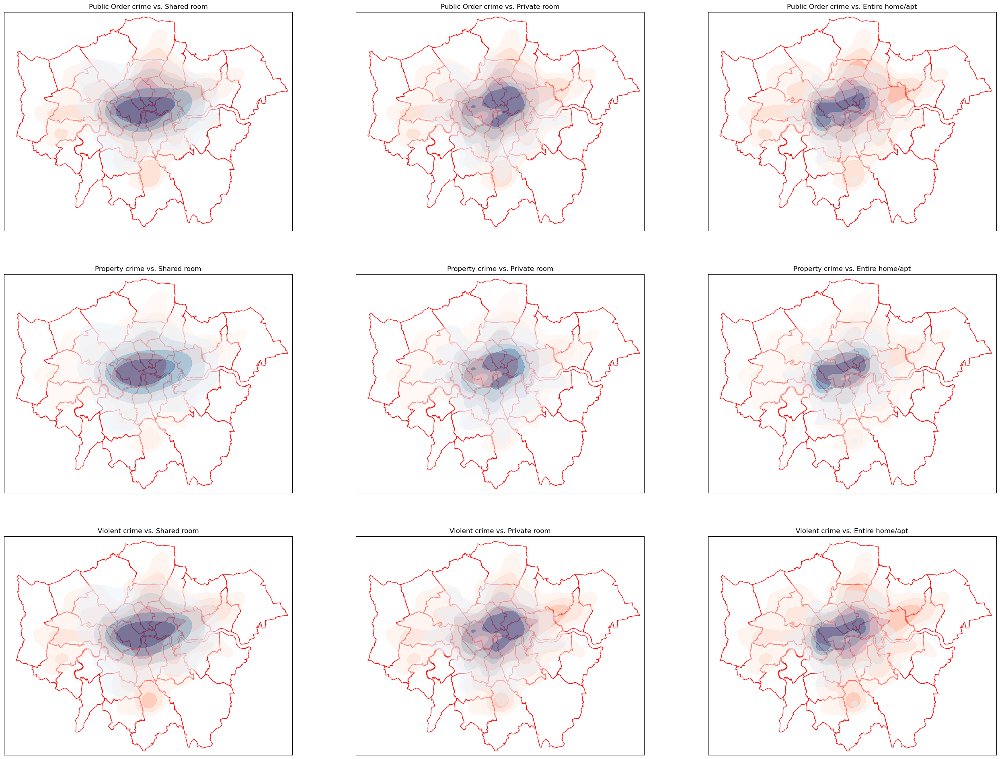

In [14]:
# KDE plot of listing types vs Crime categories
fig, axes = plt.subplots(3,3, figsize=(32,24))

# Base
for ax in fig.get_axes():
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
    ax.set_xlim([501000, 563000])
    ax.set_ylim([155000, 202000])
    boros.plot(edgecolor='red', facecolor='None',ax=ax)

# KDE maps
prop_cat = ['Shared room','Private room','Entire home/apt']
crime_cat = ['Public Order crime','Property crime','Violent crime']
# Create thresholds
levels = [0.2,0.4,0.6,0.8,1]

for i in range(3):
    for j in range (3):
        sns.kdeplot(ax=axes[i,j],
                x=crime[crime['Category']==crime_cat[i]].geometry.x,
                y=crime[crime['Category']==crime_cat[i]].geometry.y,
                levels = levels, fill=True, cmap='Reds', alpha=0.5)
        sns.kdeplot(ax=axes[i,j],
                x=listings[listings.room_type==prop_cat[j]].geometry.x,
                y=listings[listings.room_type==prop_cat[j]].geometry.y,
                levels = levels, fill=True, cmap='Blues', alpha=0.5)
        axes[i,j].set_title(f'{crime_cat[i]} vs. {prop_cat[j]}')
       
plt.show()

Run correlations + spatial autocorrelation

In [15]:
lsoa_merge = lsoa

# Spatial crime and lsoa, summarise by count
sjoin_lsoa = gpd.sjoin(crime, lsoa_merge)
count_dict = sjoin_lsoa['LSOA21CD'].value_counts().to_dict() # count the values with value counts
lsoa_merge['crime_count'] = lsoa_merge['LSOA21CD'].map(count_dict) # map it back to lsoa

In [16]:
# Spatial join listings and lsoa, summarise by count
sjoin_lsoa = gpd.sjoin(listings, lsoa_merge)
count_dict = sjoin_lsoa['LSOA21CD'].value_counts().to_dict() # count the values with value counts
lsoa_merge['listing_count'] = lsoa_merge['LSOA21CD'].map(count_dict) # map it back to lsoa

In [17]:
# Spatial join crime by severity and lsoa, summarise by count
for s in ['Public Order crime','Property crime','Violent crime']:
    sjoin_lsoa = gpd.sjoin(crime[crime['Category']==s], lsoa_merge)
    count_dict = sjoin_lsoa['LSOA21CD'].value_counts().to_dict() # count the values with value counts
    lsoa_merge[s+'_count'] = lsoa_merge['LSOA21CD'].map(count_dict) # map it back to lsoa_merge

# Sptial join listings by room type and lsoa, summarise by count
for r in ['Shared room','Private room','Entire home/apt']:
    sjoin_lsoa = gpd.sjoin(listings[listings['room_type']==r], lsoa_merge)
    count_dict = sjoin_lsoa['LSOA21CD'].value_counts().to_dict() # count the values with value counts
    lsoa_merge[r+'_count'] = lsoa_merge['LSOA21CD'].map(count_dict) # map it back to lsoa_merge

In [18]:
# Change NA to 0
lsoa_merge = lsoa_merge.fillna(0)
lsoa_merge.head()

,OBJECTID,LSOA21CD,LSOA21NM,GlobalID,geometry,crime_count,listing_count,Public Order crime_count,Property crime_count,Violent crime_count,Shared room_count,Private room_count,Entire home/apt_count
0,1,E01000001,City of London 001A,f1865556-4e62-48e3-a025-d93a40f15e46,"POLYGON ((532105.312 182010.574, 532162.491 18...",0.0,16.0,0.0,0.0,0.0,1.0,5.0,10.0
1,2,E01000002,City of London 001B,83e78aad-ee05-44a5-a8d3-077de6ed4053,"POLYGON ((532634.497 181926.016, 532619.141 18...",2.0,14.0,0.0,1.0,1.0,0.0,0.0,14.0
2,3,E01000003,City of London 001C,69c457df-229e-4446-9577-95ac1c9be694,"POLYGON ((532135.138 182198.131, 532158.250 18...",1.0,16.0,0.0,0.0,1.0,0.0,4.0,12.0
3,4,E01000005,City of London 001E,d537d59f-237a-45ed-a514-b0ab2a93e510,"POLYGON ((533808.018 180767.774, 533649.037 18...",14.0,99.0,3.0,8.0,3.0,0.0,19.0,80.0
4,5,E01000006,Barking and Dagenham 016A,8d0081fe-69e2-48ac-aaf9-fd270d60e339,"POLYGON ((545122.049 184314.931, 545271.849 18...",3.0,7.0,1.0,1.0,1.0,0.0,6.0,1.0


Text(0.5, 1.0, 'Airbnb Listing count by LSOA, Sep 2023')

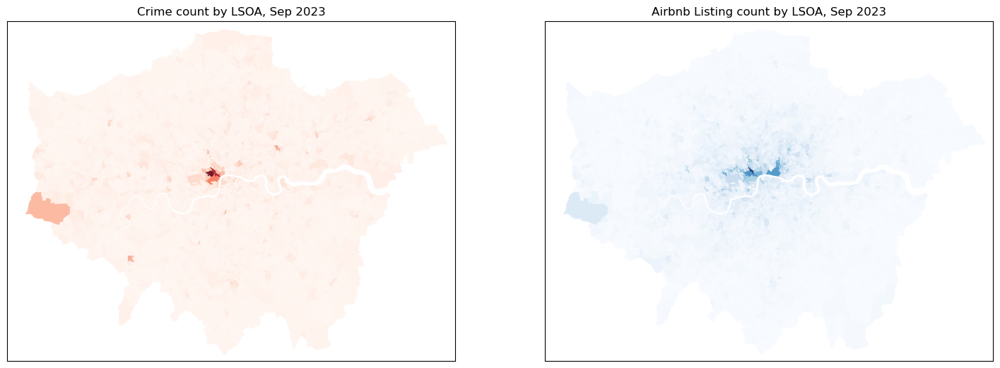

In [19]:
# Plot crime on x and listings y for lsoa_merge
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(18,24))
lsoa_merge.plot(ax=ax1, column='crime_count', legend=False, cmap='Reds', alpha=0.9)
lsoa_merge.plot(ax=ax2, column='listing_count', legend=False, cmap='Blues', alpha=0.9)

for ax in fig.get_axes():
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
    ax.set_xlim([501000, 563000])
    ax.set_ylim([155000, 202000])

ax1.set_title('Crime count by LSOA, Sep 2023')
ax2.set_title('Airbnb Listing count by LSOA, Sep 2023')

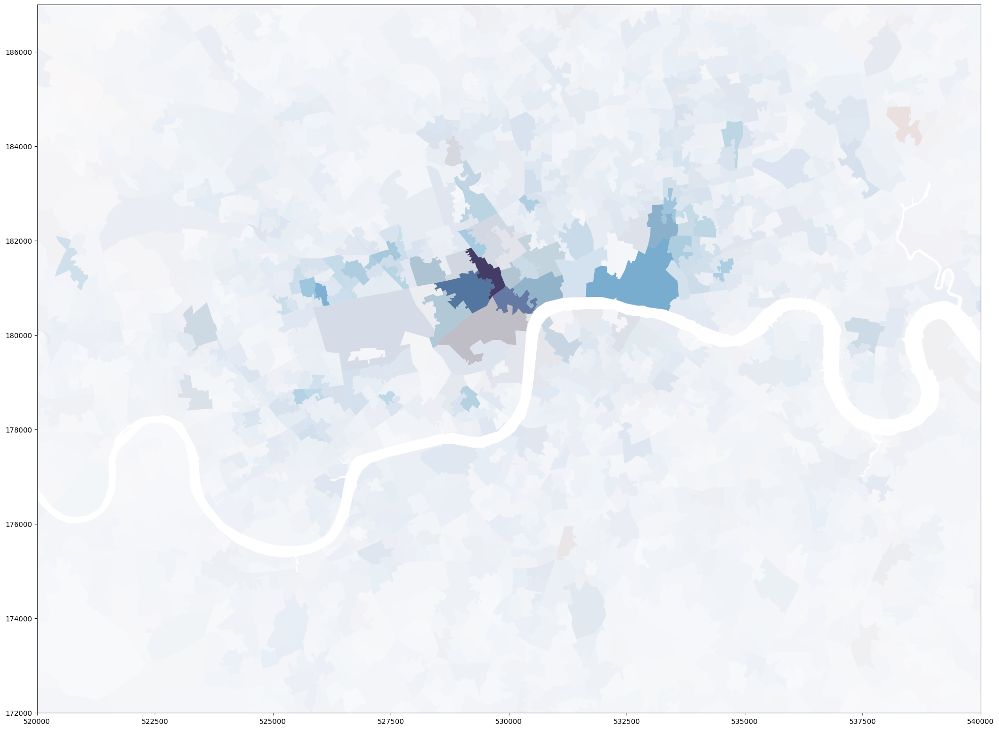

In [20]:
# Plot crime on x and listings y for lsoa_merge
fig, ax = plt.subplots(1,1, figsize=(24,24))
lsoa_merge.plot(ax=ax, column='crime_count', legend=False, cmap='Reds', alpha=0.7)
lsoa_merge.plot(ax=ax, column='listing_count', legend=False, cmap='Blues', alpha=0.7)

for ax in fig.get_axes():
    # ax.axes.xaxis.set_visible(False)
    # ax.axes.yaxis.set_visible(False)
    ax.set_xlim([520000, 540000])
    ax.set_ylim([172000, 187000])

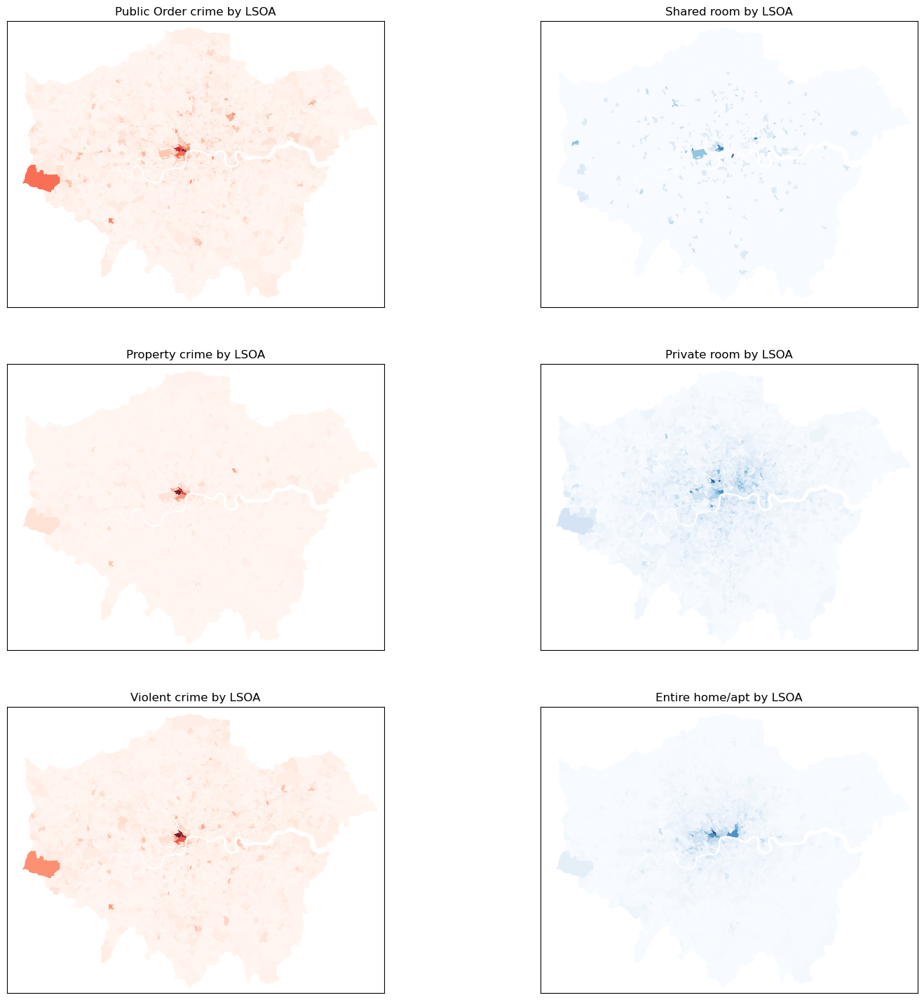

In [21]:
# Plot 3 crime types LSOA
fig, axes = plt.subplots(3,2, figsize=(18,18))

lsoa_merge.plot(ax=axes[0,0], column='Public Order crime_count', cmap='Reds', alpha=0.9)
lsoa_merge.plot(ax=axes[1,0], column='Property crime_count', cmap='Reds', alpha=0.9)
lsoa_merge.plot(ax=axes[2,0], column='Violent crime_count',  cmap='Reds', alpha=0.9)

axes[0,0].set_title('Public Order crime by LSOA')
axes[1,0].set_title('Property crime by LSOA')
axes[2,0].set_title('Violent crime by LSOA')

lsoa_merge.plot(ax=axes[0,1], column='Shared room_count',cmap='Blues', alpha=0.9)
lsoa_merge.plot(ax=axes[1,1], column='Private room_count',  cmap='Blues', alpha=0.9)
lsoa_merge.plot(ax=axes[2,1], column='Entire home/apt_count', cmap='Blues', alpha=0.9)

axes[0,1].set_title('Shared room by LSOA')
axes[1,1].set_title('Private room by LSOA')
axes[2,1].set_title('Entire home/apt by LSOA')

for ax in fig.get_axes():
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
    ax.set_xlim([501000, 563000])
    ax.set_ylim([155000, 202000])
    
plt.show()

### Correlation between airbnb vs crim

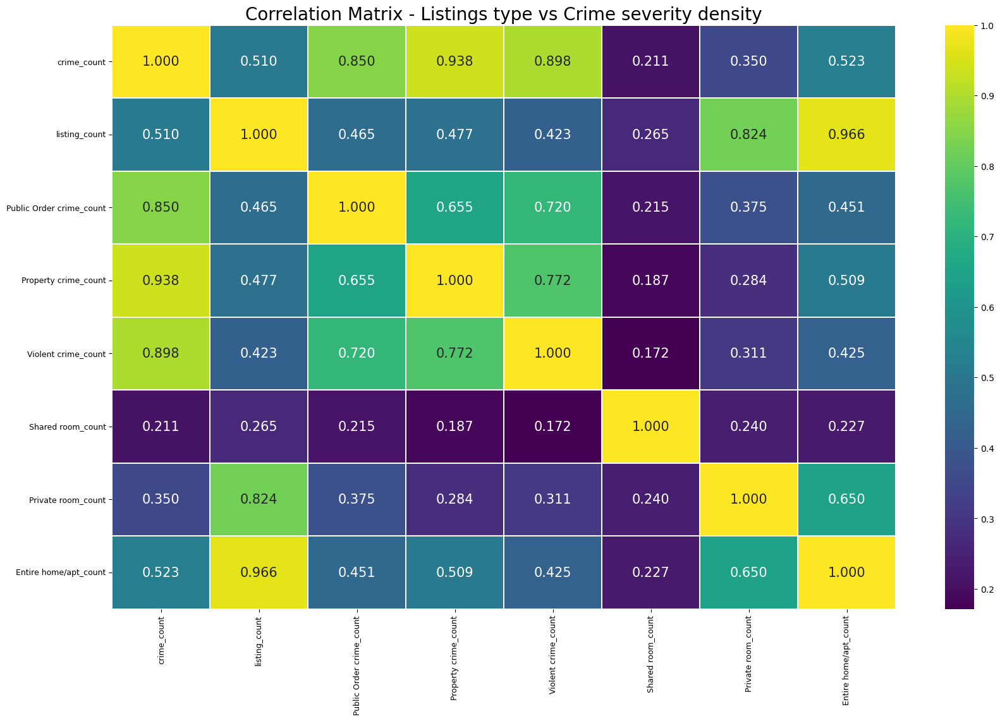

In [22]:
# make the correlation matrix
lsoa_merge_sub1 = lsoa_merge.iloc[:,-8:]
lsoa_merge_sub1_comatrix = lsoa_merge_sub1.corr()
# plot the correlation matrix plot
fig, axes = plt.subplots(figsize = (20,12))
sns.heatmap(lsoa_merge_sub1_comatrix, cmap ='viridis', annot = True, fmt='.3f', linewidths = 0.1, annot_kws = {'size': 15}, ax = axes)
axes.tick_params(labelsize = 9)
axes.set_title('Correlation Matrix - Listings type vs Crime severity density', fontsize = 20)
plt.show()

Observation:
- Entire home/apt has the highest correl to Crime (relevant to tourism), followed by Private room and Shared room
- 

### Visualise correlation on the London map

In [23]:
"""
Function to set default variables
"""

def conf_defaults():
    # Define some variables for later use
    conf = {
        'plot_title': 'Bivariate choropleth map using Ploty',  # Title text
        'plot_title_size': 20,  # Font size of the title
        'width': 1000,  # Width of the final map container
        'ratio': 0.8,  # Ratio of height to width
        'center_lat': 0,  # Latitude of the center of the map
        'center_lon': 0,  # Longitude of the center of the map
        'map_zoom': 3,  # Zoom factor of the map
        'hover_x_label': 'Label x variable',  # Label to appear on hover
        'hover_y_label': 'Label y variable',  # Label to appear on hover
        'borders_width': 0.5,  # Width of the geographic entity borders
        'borders_color': '#f8f8f8',  # Color of the geographic entity borders

        # Define settings for the legend
        'top': 1,  # Vertical position of the top right corner (0: bottom, 1: top)
        'right': 1,  # Horizontal position of the top right corner (0: left, 1: right)
        'box_w': 0.04,  # Width of each rectangle
        'box_h': 0.04,  # Height of each rectangle
        'line_color': '#f8f8f8',  # Color of the rectagles' borders
        'line_width': 0,  # Width of the rectagles' borders
        'legend_x_label': 'Higher x value',  # x variable label for the legend 
        'legend_y_label': 'Higher y value',  # y variable label for the legend
        'legend_font_size': 9,  # Legend font size
        'legend_font_color': '#333',  # Legend font color
    }

    # Calculate height
    conf['height'] = conf['width'] * conf['ratio']
    
    return conf


"""
Function to recalculate values in case width is changed
"""
def recalc_vars(new_width, variables, conf=conf_defaults()):
    
    # Calculate the factor of the changed width
    factor = new_width / 1000
    
    # Apply factor to all variables that have been passed to the function
    for var in variables:
        if var == 'map_zoom':
            # Calculate the zoom factor
            # Mapbox zoom is based on a log scale. map_zoom needs to be set 
            # to value ideal for our map at 1000px.
            # So factor = 2 ^ (zoom - map_zoom) and zoom = log(factor) / log(2) + map_zoom
            conf[var] = math.log(factor) / math.log(2) + conf[var]
        else:
            conf[var] = conf[var] * factor

    return conf


"""
Function to load GeoJSON file with geographical data of the entities
"""

def load_geojson(geojson_url, data_dir='data', local_file=False):
    
    # Make sure data_dir is a string
    data_dir = str(data_dir)
    
    # Set name for the file to be saved
    if not local_file:
        # Use original file name if none is specified
        url_parsed = urlparse(geojson_url)
        local_file = os.path.basename(url_parsed.path)
        
    geojson_file = data_dir + '/' + str(local_file)

    # Create folder for data if it does not exist
    if not os.path.exists(data_dir):
        os.makedirs(data_dir)

    # Download GeoJSON in case it doesn't exist
    if not os.path.exists(geojson_file):

        # Make http request for remote file data
        geojson_request = requests.get(geojson_url)

        # Save file to local copy
        with open(geojson_file, 'wb') as file:
            file.write(geojson_request.content)

    # Load GeoJSON file
    geojson = json.load(open(geojson_file, 'r'))
    
    # Return GeoJSON object
    return geojson


"""
Function that assigns a value (x) to one of three bins (0, 1, 2).
The break points for the bins can be defined by break_1 and break_2.
"""

def set_interval_value(x, break_1, break_2):
    if x <= break_1: 
        return 0
    elif break_1 < x <= break_2: 
        return 1
    else: 
        return 2


"""
Function that adds a column 'biv_bins' to the dataframe containing the 
position in the 9-color matrix for the bivariate colors
    
Arguments:
    df: Dataframe
    x: Name of the column containing values of the first variable
    y: Name of the column containing values of the second variable

"""

def prepare_df(df, x='x', y='y'):
    
    # Check if arguments match all requirements
    if df[x].shape[0] != df[y].shape[0]:
        raise ValueError('ERROR: The list of x and y coordinates must have the same length.')
    
    # Calculate break points at percentiles 33 and 66
    x_breaks = np.percentile(df[x], [33, 66])
    y_breaks = np.percentile(df[y], [33, 66])
    
    # Assign values of both variables to one of three bins (0, 1, 2)
    x_bins = [set_interval_value(value_x, x_breaks[0], x_breaks[1]) for value_x in df[x]]
    y_bins = [set_interval_value(value_y, y_breaks[0], y_breaks[1]) for value_y in df[y]]
    
    # Calculate the position of each x/y value pair in the 9-color matrix of bivariate colors
    df['biv_bins'] = [int(value_x + 3 * value_y) for value_x, value_y in zip(x_bins, y_bins)]
    
    return df
   


"""
Function to create a color square containig the 9 colors to be used as a legend
"""

def create_legend(fig, colors, conf=conf_defaults()):
    
    # Reverse the order of colors
    legend_colors = colors[:]
    legend_colors.reverse()

    # Calculate coordinates for all nine rectangles
    coord = []

    # Adapt height to ratio to get squares
    width = conf['box_w']
    height = conf['box_h']/conf['ratio']
    
    # Start looping through rows and columns to calculate corners the squares
    for row in range(1, 4):
        for col in range(1, 4):
            coord.append({
                'x0': round(conf['right']-(col-1)*width, 4),
                'y0': round(conf['top']-(row-1)*height, 4),
                'x1': round(conf['right']-col*width, 4),
                'y1': round(conf['top']-row*height, 4)
            })

    # Create shapes (rectangles)
    for i, value in enumerate(coord):
        # Add rectangle
        fig.add_shape(go.layout.Shape(
            type='rect',
            fillcolor=legend_colors[i],
            line=dict(
                color=conf['line_color'],
                width=conf['line_width'],
            ),
            xref='paper',
            yref='paper',
            xanchor='right',
            yanchor='top',
            x0=coord[i]['x0'],
            y0=coord[i]['y0'],
            x1=coord[i]['x1'],
            y1=coord[i]['y1'],
        ))
    
        # Add text for first variable
        fig.add_annotation(
            xref='paper',
            yref='paper',
            xanchor='left',
            yanchor='top',
            x=coord[8]['x1'],
            y=coord[8]['y1'],
            showarrow=False,
            text=conf['legend_x_label'] + ' 🠒',
            font=dict(
                color=conf['legend_font_color'],
                size=conf['legend_font_size'],
            ),
            borderpad=0,
        )
        
        # Add text for second variable
        fig.add_annotation(
            xref='paper',
            yref='paper',
            xanchor='right',
            yanchor='bottom',
            x=coord[8]['x1'],
            y=coord[8]['y1'],
            showarrow=False,
            text=conf['legend_y_label'] + ' 🠒',
            font=dict(
                color=conf['legend_font_color'],
                size=conf['legend_font_size'],
            ),
            textangle=270,
            borderpad=0,
        )
    
    return fig


"""
Function to create the map

Arguments:
    df: The dataframe that contains all the necessary columns
    colors: List of 9 blended colors
    x: Name of the column that contains values of first variable (defaults to 'x')
    y: Name of the column that contains values of second variable (defaults to 'y')
    ids: Name of the column that contains ids that connect the data to the GeoJSON (defaults to 'id')
    name: Name of the column conatining the geographic entity to be displayed as a description (defaults to 'name')
"""

def create_bivariate_map(df, colors, geojson, x='x', y='y', ids='id', name='name', conf=conf_defaults()):
    
    if len(colors) != 9:
        raise ValueError('ERROR: The list of bivariate colors must have a length eaqual to 9.')
    
    # Recalculate values if width differs from default
    if not conf['width'] == 1000:             
        conf = recalc_vars(conf['width'], ['height', 'plot_title_size', 'legend_font_size', 'map_zoom'], conf)
        
    # Prepare the dataframe with the necessary information for our bivariate map
    df_plot = prepare_df(df, x, y)
    
    # Create the figure
    fig = go.Figure(go.Choroplethmapbox(
        geojson=geojson,
        locations=df_plot[ids],
        z=df_plot['biv_bins'],
        marker_line_width=.5,
        colorscale=[
            [0/8, colors[0]],
            [1/8, colors[1]],
            [2/8, colors[2]],
            [3/8, colors[3]],
            [4/8, colors[4]],
            [5/8, colors[5]],
            [6/8, colors[6]],
            [7/8, colors[7]],
            [8/8, colors[8]],
        ],
        customdata=df_plot[[name, ids, x, y]],  # Add data to be used in hovertemplate
        hovertemplate='<br>'.join([  # Data to be displayed on hover
            '<b>%{customdata[0]}</b> (ID: %{customdata[1]})',
            conf['hover_x_label'] + ': %{customdata[2]}',
            conf['hover_y_label'] + ': %{customdata[3]}',
            '<extra></extra>',  # Remove secondary information
        ])
    ))

    # Add some more details
    fig.update_layout(
        title=dict(
            text=conf['plot_title'],
            font=dict(
                size=conf['plot_title_size'],
            ),
        ),
        mapbox_style='white-bg',
        width=conf['width'],
        height=conf['height'],
        autosize=True,
        mapbox=dict(
            center=dict(lat=conf['center_lat'], lon=conf['center_lon']),  # Set map center
            zoom=conf['map_zoom']  # Set zoom
        ),
    )

    fig.update_traces(
        marker_line_width=conf['borders_width'],  # Width of the geographic entity borders
        marker_line_color=conf['borders_color'],  # Color of the geographic entity borders
        showscale=False,  # Hide the colorscale
    )

    # Add the legend
    fig = create_legend(fig, colors, conf)
    
    return fig

In [24]:
# Define sets of 9 colors to be used
# Order: bottom-left, bottom-center, bottom-right, center-left, center-center, center-right, top-left, top-center, top-right
color_sets = {
    'pink-blue':   ['#e8e8e8', '#ace4e4', '#5ac8c8', '#dfb0d6', '#a5add3', '#5698b9', '#be64ac', '#8c62aa', '#3b4994'],
    'teal-red':    ['#e8e8e8', '#e4acac', '#c85a5a', '#b0d5df', '#ad9ea5', '#985356', '#64acbe', '#627f8c', '#574249'],
    'blue-orange': ['#fef1e4', '#fab186', '#f3742d',  '#97d0e7', '#b0988c', '#ab5f37', '#18aee5', '#407b8f', '#5c473d']
}

In [25]:
# Load conf defaults
conf = conf_defaults()

# Override some variables
conf['plot_title'] = 'Airbnb and Crime in London'
conf['hover_x_label'] = 'Airbnb'  # Label to appear on hover
conf['hover_y_label'] = 'Crime'  # Label to appear on hover
conf['width'] = 1000
conf['center_lat'] = 51.5  # Latitude of the center of the map
conf['center_lon'] = -0.1  # Longitude of the center of the map
conf['map_zoom'] = 9.5  # Zoom factor of the map
conf['borders_width'] = 0  # Width of the geographic entity borders

# Define settings for the legend
conf['top'] = 0.5  # Vertical position of the top right corner (0: bottom, 1: top)
conf['right'] = 0.1  # Horizontal position of the top right corner (0: left, 1: right)
conf['line_width'] = 0  # Width of the rectangles' borders
conf['legend_x_label'] = 'Higher airbnb'  # x variable label for the legend 
conf['legend_y_label'] = 'More Crime'  # y variable label for the legend

In [26]:
# Convert shapefil to geojson that the visualisation function requires
lsoa_merge_wgs = lsoa_merge.to_crs(4326)
lsoa_merge_wgs.to_file(os.path.join('data','lsoa_merge.geojson'))
geojson = json.load(open(os.path.join('data','lsoa_merge.geojson'), 'r')) 
# Iterate over JSON to add necessary 'id' property
for i in range(len(geojson['features'])):
    geojson['features'][i]['id'] = geojson['features'][i]['properties']['LSOA21CD']

In [27]:
import plotly.graph_objs as go
fig = create_bivariate_map(lsoa_merge, color_sets['blue-orange'], geojson , x='listing_count', y='crime_count', ids='LSOA21CD', name='LSOA21NM', conf=conf)
fig.show()

In [ ]:
# calculating VIF
# This function is adjusted from: https://stackoverflow.com/a/51329496/4667568
from statsmodels.stats.outliers_influence import variance_inflation_factor 
from statsmodels.tools.tools import add_constant

def drop_column_using_vif_(df, thresh=5):
    '''
    Calculates VIF each feature in a pandas dataframe, and repeatedly drop the columns with the highest VIF
    A constant must be added to variance_inflation_factor or the results will be incorrect

    :param df: the pandas dataframe containing only the predictor features, not the response variable
    :param thresh: (default 5) the threshould VIF value. If the VIF of a variable is greater than thresh, it should be removed from the dataframe
    :return: dataframe with multicollinear features removed
    '''
    while True:
        # adding a constatnt item to the data. add_constant is a function from statsmodels (see the import above)
        df_with_const = add_constant(df)

        vif_df = pd.Series([variance_inflation_factor(df_with_const.values, i) 
               for i in range(df_with_const.shape[1])], name= "VIF",
              index=df_with_const.columns).to_frame()

        # drop the const
        vif_df = vif_df.drop('const')
        
        # if the largest VIF is above the thresh, remove a variable with the largest VIF
        # If there are multiple variabels with VIF>thresh, only one of them is removed. This is because we want to keep as many variables as possible
        if vif_df.VIF.max() > thresh:
            # If there are multiple variables with the maximum VIF, choose the first one
            index_to_drop = vif_df.index[vif_df.VIF == vif_df.VIF.max()].tolist()[0]
            print('Dropping: {}'.format(index_to_drop))
            df = df.drop(columns = index_to_drop)
        else:
            # No VIF is above threshold. Exit the loop
            break

    return df

### Inferring statistics (Question #7 - 45 points)

*Objective:* 
Show causation and infer recommendations

1. Step 1
2. Step 2
3. Step 3

In [28]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.offsetbox import AnchoredText  # for adding some text

In [29]:
lsoa_stat.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4994 entries, 0 to 4993
Data columns (total 235 columns):
 #    Column                                                                           Dtype 
---   ------                                                                           ----- 
 0    LSOA code                                                                        object
 1    local authority code                                                             object
 2    local authority name                                                             object
 3    All households                                                                   int64 
 4    Detached                                                                         int64 
 5    Semi-detached                                                                    int64 
 6    Terraced                                                                         int64 
 7    Purpose built flat                      

Chosen columns:
X
- Population density: Usual resident (11) / Area (need to get)
- Bad+Very Bad Health (120+121) / Pop (11)
- deprived 2+ dimension (144+145+146) / Pop (11)
- Unemployed (72) / Pop (11)
- Young people (17+18+19) / Pop (11)
- 3x Airbnb listings (3 types) / Household number (3)
Y
- Crime-relevant / Pop (11)

In [44]:
# Select columns
lsoa_stat_selected = lsoa_stat
lsoa_stat_selected['deprived_2+_dimension_density'] = (lsoa_stat['3 dimensions'] + lsoa_stat['4 dimensions'])/lsoa_stat['All Households']
lsoa_stat_selected['unemployed_density'] = (lsoa_stat['Economically active: Unemployed'])/lsoa_stat['All usual residents aged 16 or over']
lsoa_stat_selected['young_people_density'] = (lsoa_stat['Aged 15 '] + lsoa_stat['Aged 16 to 17'] + lsoa_stat['Aged 18 to 19'] + lsoa_stat['Aged 20 to 24'])/lsoa_stat['All usual residents']
lsoa_stat_selected['qual_level_3+_density'] = (lsoa_stat['Level 3'] + lsoa_stat['Level 4+'] )/lsoa_stat['Usual residents aged 16+']
lsoa_stat_selected['social_rent_density'] = (lsoa_stat['Other social rented'] + lsoa_stat['Rented from Local Authority'] )/lsoa_stat['All Households']

In [45]:
# Merge selected columns from lsoa_stat to lsoa_merge by LSOA21CD
lsoa_merge1 = lsoa_merge.merge(lsoa_stat_selected[['LSOA code',
                                                  'deprived_2+_dimension_density',
                                                  'unemployed_density',
                                                  'young_people_density',
                                                  'qual_level_3+_density',
                                                  'social_rent_density',
                                                  'All Households',
                                                  'All usual residents aged 16 or over',
                                                  'All usual residents']], 
                               left_on = 'LSOA21CD',right_on='LSOA code', how='left').drop(columns=['LSOA code'])

In [47]:
lsoa_merge1.columns

Index(['OBJECTID', 'LSOA21CD', 'LSOA21NM', 'GlobalID', 'geometry',
       'crime_count', 'listing_count', 'Public Order crime_count',
       'Property crime_count', 'Violent crime_count', 'Shared room_count',
       'Private room_count', 'Entire home/apt_count', 'biv_bins',
       'deprived_2+_dimension_density', 'unemployed_density',
       'young_people_density', 'qual_level_3+_density', 'social_rent_density',
       'All Households', 'All usual residents aged 16 or over',
       'All usual residents'],
      dtype='object')

In [49]:
# Add density for each column in lsoa_merge1
lsoa_merge1['crime_density'] = lsoa_merge1['crime_count']/lsoa_merge1['All usual residents']
lsoa_merge1['listing_density'] = lsoa_merge1['listing_count']/lsoa_merge1['All Households']
lsoa_merge1['Shared room_density'] = lsoa_merge1['Shared room_count']/lsoa_merge1['All Households']
lsoa_merge1['Private room_density'] = lsoa_merge1['Private room_count']/lsoa_merge1['All Households']
lsoa_merge1['Entire home/apt_density'] = lsoa_merge1['Entire home/apt_count']/lsoa_merge1['All Households']
lsoa_merge1['Public Order crime_density'] = lsoa_merge1['Public Order crime_count']/lsoa_merge1['All usual residents']
lsoa_merge1['Property crime_density'] = lsoa_merge1['Property crime_count']/lsoa_merge1['All usual residents']
lsoa_merge1['Violent crime_density'] = lsoa_merge1['Violent crime_count']/lsoa_merge1['All usual residents']
lsoa_merge1['area'] = lsoa_merge1['geometry'].area
lsoa_merge1['pop_density'] = lsoa_merge1['All usual residents']/lsoa_merge1['area']

In [50]:
lsoa_merge1.columns

Index(['OBJECTID', 'LSOA21CD', 'LSOA21NM', 'GlobalID', 'geometry',
       'crime_count', 'listing_count', 'Public Order crime_count',
       'Property crime_count', 'Violent crime_count', 'Shared room_count',
       'Private room_count', 'Entire home/apt_count', 'biv_bins',
       'deprived_2+_dimension_density', 'unemployed_density',
       'young_people_density', 'qual_level_3+_density', 'social_rent_density',
       'All Households', 'All usual residents aged 16 or over',
       'All usual residents', 'crime_density', 'listing_density',
       'Shared room_density', 'Private room_density',
       'Entire home/apt_density', 'Public Order crime_density',
       'Property crime_density', 'Violent crime_density', 'area',
       'pop_density'],
      dtype='object')

 Avoid multicollinear

In [51]:
# calculating VIF
# This function is adjusted from: https://stackoverflow.com/a/51329496/4667568
from statsmodels.stats.outliers_influence import variance_inflation_factor 
from statsmodels.tools.tools import add_constant

def drop_column_using_vif_(df, thresh=5):
    '''
    Calculates VIF each feature in a pandas dataframe, and repeatedly drop the columns with the highest VIF
    A constant must be added to variance_inflation_factor or the results will be incorrect

    :param df: the pandas dataframe containing only the predictor features, not the response variable
    :param thresh: (default 5) the threshould VIF value. If the VIF of a variable is greater than thresh, it should be removed from the dataframe
    :return: dataframe with multicollinear features removed
    '''
    while True:
        # adding a constatnt item to the data. add_constant is a function from statsmodels (see the import above)
        df_with_const = add_constant(df)

        vif_df = pd.Series([variance_inflation_factor(df_with_const.values, i) 
               for i in range(df_with_const.shape[1])], name= "VIF",
              index=df_with_const.columns).to_frame()

        # drop the const
        vif_df = vif_df.drop('const')
        
        # if the largest VIF is above the thresh, remove a variable with the largest VIF
        # If there are multiple variabels with VIF>thresh, only one of them is removed. This is because we want to keep as many variables as possible
        if vif_df.VIF.max() > thresh:
            # If there are multiple variables with the maximum VIF, choose the first one
            index_to_drop = vif_df.index[vif_df.VIF == vif_df.VIF.max()].tolist()[0]
            print('Dropping: {}'.format(index_to_drop))
            df = df.drop(columns = index_to_drop)
        else:
            # No VIF is above threshold. Exit the loop
            break

    return df

In [53]:
density_cols = [col for col in lsoa_merge1.columns if 'density' in col]
print(list(lsoa_merge1.columns))
print(density_cols)

['OBJECTID', 'LSOA21CD', 'LSOA21NM', 'GlobalID', 'geometry', 'crime_count', 'listing_count', 'Public Order crime_count', 'Property crime_count', 'Violent crime_count', 'Shared room_count', 'Private room_count', 'Entire home/apt_count', 'biv_bins', 'deprived_2+_dimension_density', 'unemployed_density', 'young_people_density', 'qual_level_3+_density', 'social_rent_density', 'All Households', 'All usual residents aged 16 or over', 'All usual residents', 'crime_density', 'listing_density', 'Shared room_density', 'Private room_density', 'Entire home/apt_density', 'Public Order crime_density', 'Property crime_density', 'Violent crime_density', 'area', 'pop_density']
['deprived_2+_dimension_density', 'unemployed_density', 'young_people_density', 'qual_level_3+_density', 'social_rent_density', 'crime_density', 'listing_density', 'Shared room_density', 'Private room_density', 'Entire home/apt_density', 'Public Order crime_density', 'Property crime_density', 'Violent crime_density', 'pop_density

In [54]:
lsoa_merge2 = lsoa_merge1.loc[:,density_cols]
lsoa_merge2.columns

Index(['deprived_2+_dimension_density', 'unemployed_density',
       'young_people_density', 'qual_level_3+_density', 'social_rent_density',
       'crime_density', 'listing_density', 'Shared room_density',
       'Private room_density', 'Entire home/apt_density',
       'Public Order crime_density', 'Property crime_density',
       'Violent crime_density', 'pop_density'],
      dtype='object')

In [55]:
lsoa_merge2_VIF = drop_column_using_vif_(lsoa_merge2)
print(lsoa_merge2.columns)
print(lsoa_merge2_VIF.columns)

/opt/conda/lib/python3.11/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning:

divide by zero encountered in scalar divide

/opt/conda/lib/python3.11/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning:

divide by zero encountered in scalar divide



Dropping: crime_density
Dropping: listing_density
Index(['deprived_2+_dimension_density', 'unemployed_density',
       'young_people_density', 'qual_level_3+_density', 'social_rent_density',
       'crime_density', 'listing_density', 'Shared room_density',
       'Private room_density', 'Entire home/apt_density',
       'Public Order crime_density', 'Property crime_density',
       'Violent crime_density', 'pop_density'],
      dtype='object')
Index(['deprived_2+_dimension_density', 'unemployed_density',
       'young_people_density', 'qual_level_3+_density', 'social_rent_density',
       'Shared room_density', 'Private room_density',
       'Entire home/apt_density', 'Public Order crime_density',
       'Property crime_density', 'Violent crime_density', 'pop_density'],
      dtype='object')


# OSL

In [63]:
regressiondata = lsoa_merge1.drop(['listing_density','crime_density','biv_bins','geometry','OBJECTID', 'LSOA21CD', 'LSOA21NM', 'GlobalID','area'],axis=1)
regressiondata = regressiondata.drop([col for col in lsoa_merge1.columns if 'count' in col],axis=1)
regressiondata = regressiondata.drop([col for col in lsoa_merge1.columns if 'All' in col],axis=1)
                                  
regressiondata.columns

Index(['deprived_2+_dimension_density', 'unemployed_density',
       'young_people_density', 'qual_level_3+_density', 'social_rent_density',
       'Shared room_density', 'Private room_density',
       'Entire home/apt_density', 'Public Order crime_density',
       'Property crime_density', 'Violent crime_density', 'pop_density'],
      dtype='object')

In [64]:
import statsmodels.api as sm
ols = sm.OLS(endog=regressiondata[['Property crime_density']], exog=sm.add_constant(regressiondata[['deprived_2+_dimension_density', 'unemployed_density',
       'young_people_density', 'qual_level_3+_density', 'social_rent_density',
       'Shared room_density', 'Private room_density',
       'Entire home/apt_density', 'Public Order crime_density',
       'Property crime_density', 'Violent crime_density', 'pop_density']]))
model = ols.fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              OLS Regression Results                              
==================================================================================
Dep. Variable:     Property crime_density   R-squared:                       1.000
Model:                                OLS   Adj. R-squared:                  1.000
Method:                     Least Squares   F-statistic:                 1.205e+31
Date:                    Sat, 16 Dec 2023   Prob (F-statistic):               0.00
Time:                            11:22:12   Log-Likelihood:             1.8157e+05
No. Observations:                    4994   AIC:                        -3.631e+05
Df Residuals:                        4981   BIC:                        -3.630e+05
Df Model:                              12                                         
Covariance Type:                nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                         -6.115e-17   4.76e-18    -12.856      0.000   -7.05e-17   -5.18e-17
deprived_2+_dimension_density -1.561e-17   3.82e-17     -0.409      0.683   -9.05e-17    5.93e-17
unemployed_density            -1.344e-16   5.94e-17     -2.262      0.024   -2.51e-16   -1.79e-17
young_people_density           8.578e-16   1.47e-17     58.191      0.000    8.29e-16    8.87e-16
qual_level_3+_density         -3.296e-17   6.47e-18     -5.091      0.000   -4.57e-17   -2.03e-17
social_rent_density           -6.657e-17   5.35e-18    -12.433      0.000   -7.71e-17   -5.61e-17
Shared room_density             1.86e-15   1.31e-15      1.416      0.157   -7.14e-16    4.43e-15
Private room_density          -3.305e-16   7.67e-17     -4.310      0.000   -4.81e-16    -1.8e-16
Entire home/apt_density       -3.469e-18   4.26e-17     -0.082      0.935   -8.69e-17       8e-17
Public Order crime_density    -6.141e-16   2.13e-16     -2.881      0.004   -1.03e-15   -1.96e-16
Property crime_density            1.0000   1.39e-16    7.2e+15      0.000       1.000       1.000
Violent crime_density         -3.331e-16   2.88e-16     -1.157      0.248   -8.98e-16    2.32e-16
pop_density                   -1.926e-16   9.61e-17     -2.004      0.045   -3.81e-16    -4.2e-18
==============================================================================
Omnibus:                      643.162   Durbin-Watson:                   0.728
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1018.778
Skew:                          -0.902   Prob(JB):                    5.96e-222
Kurtosis:                       4.282   Cond. No.                     2.83e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.83e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

### LASSO (not very helpful if used on a filter list of columns)

In [86]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV


X1 = lsoa_stat.select_dtypes(include=[np.number]).drop([col for col in lsoa_stat.columns if 'density' in col],axis=1)
y1 = lsoa_merge1['crime_count']


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.2, random_state=23)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Create and fit the Lasso regression model
lasso_model = Lasso(alpha=2, max_iter = 1000000, tol = 1e-20)  # Adjust the alpha parameter to control the strength of regularization (less alpha will remain more variables)
lasso_model.fit(X_train_scaled, y_train)

# Output the selected features and their coefficients
selected_features = X1.columns[lasso_model.coef_ != 0]
coefficients = lasso_model.coef_[lasso_model.coef_ != 0]

print("Selected features:")
print(selected_features)
print("Corresponding coefficients:")
print(coefficients)

Selected features:
Index(['none'], dtype='object')
Corresponding coefficients:
[0.16180111]


Another way to filter our relevant variables with LASSO?

## Residual analysis

In [ ]:
# Residuals vs. Fitted plot

# Set the figure size
plt.figure(figsize=(8, 6))  
# alpha = 0.5: controlling the transparency of the markers. Here alpha = 0.5 means that the markers are semi-transparent.
# s = 20: controlling the size of the markers. The default value is plt.rcParams['lines.markersize'] ** 2. Here we set it as 20.
# To get the default value of marker size, run the following line
# print(plt.rcParams['lines.markersize'] ** 2) 
plt.scatter(model.fittedvalues, model.resid, alpha = 0.5, s=20)
# plt.scatter(model_bike_rental.fittedvalues, model_bike_rental.resid, alpha = 0.5)
# adding title and labels
plt.xlabel('Fitted bike rental')
plt.ylabel('Residual')
plt.title('Residual vs. Fitted Plot of bike rental')
# Adding grid lines
plt.grid(True)
plt.show()

In [ ]:
# Histogram of residuals

# Set the figure size
plt.figure(figsize=(8, 6))  

# Plotting the histogram
plt.hist(model.resid, bins=20, color='skyblue', edgecolor='black', alpha=0.7)

# Adding labels and title
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Histogram of Residuals of the Linear Model')

# Adding grid lines (optional)
plt.grid(True)

# Display the plot
plt.show()

In [ ]:
# (optional) the QQ plot of residuals
# More details: https://www.statsmodels.org/dev/generated/statsmodels.graphics.gofplots.qqplot.html
fig = sm.qqplot(model.resid, fit=True, line="45")
plt.title('QQ Plot of Residuals')

# Adding grid lines (optional)
plt.grid(True)

# Display the plot
plt.show()

## Discussion of the four conditions 

- Linear relationship

The points in the residual plot do not bounce randomly around the x axis (residual=0). Therefore, it looks like ther is no linear relationship between the variables.

- Independent errors

The points in the residual plot are not randomly distributed and some clusters/patterns can be seens. Therefore, it is unlikely that the errors are independently distributed.

- Normally distributed errors

The histogram is asymmetric ans shows a positive skew, with more data points clustered to the right of residual=0.

The QQ plot shows that the residuals deviates from the theoretical quantiles when the residual value is very small or large.

Therefore, it is not likely that the residuals are normally distributed.

- Equal variance

The points do not form a horizontal band around residual=0, and the range of residuals increases with the fitted y value. Therefore, it is unlikely that the residuals have equal variance.


## Statistical tests of the four conditions

### Linear relationship

In [ ]:
import statsmodels
test_fires = statsmodels.stats.diagnostic.linear_rainbow(model)
# This function returns a tuple consisting of two values: the test statistic based on the F test and the pvalue of the test
# Note that these two values are not named. Therefore, you need to know the order before accessing these two values.
print("The p value of the fires test: {:.4f}".format(test_fires[1]))

As the p value is less than 0.05, we will reject the null hypothesis. This dataset and model does not meet the linear relationship condition.

### Independent errors

We will use the Durbin-Watson test and and Ljung-Box test for testing the independent errors. 

This test assumes that there is no serial correlation in the residuals. 

This statistic will always be between 0 and 4. 

If there is no serial correlation, the test statistic equals 2. 

The closer to 0, the more evidence for positive serial correlation. 

The closer to 4, the more evidence for negative serial correlation. 

Empirically, if the test statistic is between 1 and 2, it is likely that there is no serial correlation in the residuals.

In [ ]:
test_dw = statsmodels.stats.stattools.durbin_watson(model.resid)
print("Durbin-Watson test statistic is: {:.4f}".format(test_dw))

demonstrates that there might be serial correlation in this model and the residuals are not independently distributed.

### Normally distributed errors

We will use the Jarque-Bera test for testing the normality of residuals. 

The null hypothesis of this test is that the data is normally distributed.


In [ ]:
test_JB = statsmodels.stats.stattools.jarque_bera(model.resid)
print("The p value of the Jarque Bera test: {:.4f}".format(test_JB[1]))

As the p value is less than 0.05, we will reject the null hypothesis and conclude that the residuals are not normally distributed.

# The Spatial Lag model

Moran’s I shows spatial autocorrelation

In [ ]:
import pandas as pd
from libpysal.cg import KDTree, RADIUS_EARTH_MILES
from libpysal.weights import KNN
from spreg import ML_Lag

X = lsoa_merge1[['listing_density_Shared room', 'listing_density_Private room', 'listing_density_Entire home/apt']].to_numpy()
y = lsoa_merge1['crime_density'].to_numpy()
# Extract the centroids of the polygons
centroids = lsoa_merge1['geometry'].centroid

# Create a KDTree using the centroids
tree = KDTree(data=list(zip(centroids.x, centroids.y)),
              distance_metric='arc', radius=RADIUS_EARTH_MILES)

# Create a KNN weights matrix
nn = KNN(tree, k=5)



mod = ML_Lag(
    y=y,
    x=X,
    w=nn,
    name_y='crime_density',
    name_x=['listing_density_Shared room', 'listing_density_Private room', 'listing_density_Entire home/apt']
)

# results


print(mod.summary)

In [ ]:
mapping = {}
for b in ['Enfield','Waltham Forest','Redbridge','Barking and Dagenham','Havering','Greenwich','Bexley']:
    mapping[b]='Outer East and North East'
for b in ['Haringey','Islington','Hackney','Tower Hamlets','Newham','Lambeth','Southwark','Lewisham']:
    mapping[b]='Inner East'
for b in ['Bromley','Croydon','Sutton','Merton','Kingston upon Thames']:
    mapping[b]='Outer South'
for b in ['Wandsworth','Kensington and Chelsea','Hammersmith and Fulham','Westminster','Camden']:
    mapping[b]='Inner West'
for b in ['Richmond upon Thames','Hounslow','Ealing','Hillingdon','Brent','Harrow','Barnet','City of London']:
    mapping[b]='Outer West and North West'
print(len(mapping.keys()))